In [1]:
import csv
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import tifffile as tiff

In [2]:
%matplotlib inline

<h3>Lists and variables </h3>

Because the dataset we are working with in this project is fairly large, the following cell is needed to not get an field larger than field limit Error when using the csv module.

In [3]:
#to load large files
maxInt = sys.maxsize
decrement = True
while decrement:
    # decrease the maxInt value by factor 10 
    # as long as the OverflowError occurs.
    decrement = False
    try:
        csv.field_size_limit(maxInt)
    except OverflowError:
        maxInt = int(maxInt/10)
        decrement = True

<h3>Visualizing</h3>

In [4]:
#display helper functions
def adjust_contrast(x):    
    for i in range(3):
        x[:,:,i] = stretch2(x[:,:,i])
    return x.astype(np.uint8)

def stretch2(band, lower_percent=2, higher_percent=98):
    a = 0 #np.min(band)
    b = 255  #np.max(band)
    c = np.percentile(band, lower_percent)
    d = np.percentile(band, higher_percent)        
    out = a + (band - c) * (b - a) / (d - c)    
    out[out<a] = a
    out[out>b] = b
    return out

In [5]:
def plot_5_by_5(list_of_id):
    fig, ax = plt.subplots(5, 5, figsize=(20, 20))
    for k in list_of_id:
        i = int(k[5])
        j = int(k[7])
        temp = tiff.imread('./data/three_band/{}.tif'.format(k))
        temp = np.rollaxis(temp, 0, 3)
        y = adjust_contrast(temp).copy()
        ax[i, j].imshow(y)
        ax[i, j].axis('off')
    fig.subplots_adjust(wspace=0, hspace=0)

In [6]:
grid_sizes = pd.read_csv('./input/grid_sizes.csv')
grid_sizes.rename(columns={'Unnamed: 0':'ImageId'}, inplace=True)
allImageIds = grid_sizes.ImageId.unique()
wkt_df = pd.read_csv('./input/train_wkt_v4.csv')
wkt_df.ImageId.unique()

array(['6040_2_2', '6120_2_2', '6120_2_0', '6090_2_0', '6040_1_3',
       '6040_1_0', '6100_1_3', '6010_4_2', '6110_4_0', '6140_3_1',
       '6110_1_2', '6100_2_3', '6150_2_3', '6160_2_1', '6140_1_2',
       '6110_3_1', '6010_4_4', '6170_2_4', '6170_4_1', '6170_0_4',
       '6060_2_3', '6070_2_3', '6010_1_2', '6040_4_4', '6100_2_2'], dtype=object)

In [7]:
#plot all images
def visualizer(temp_set_id):
    list_of_id = []
    for i in allImageIds:
        if i[0:4] == temp_set_id:
            list_of_id.append(i)
    plot_5_by_5(list_of_id)

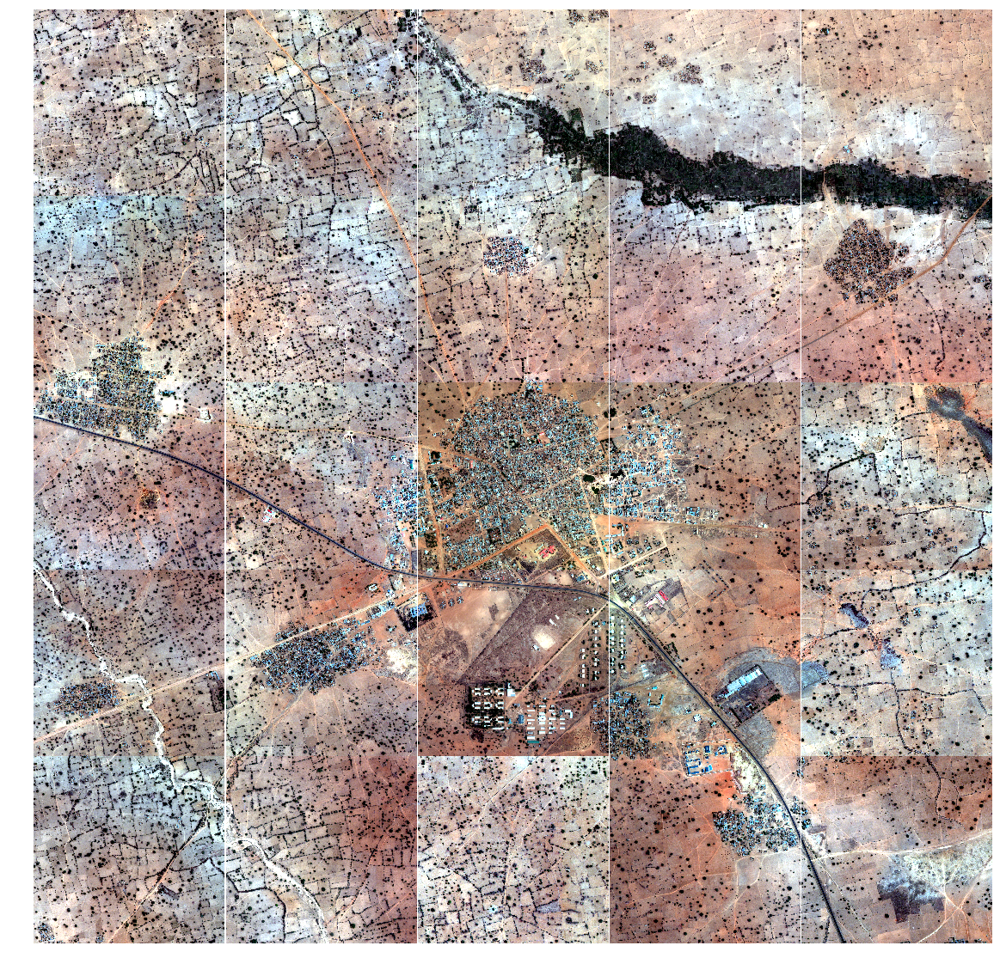

In [8]:
visualizer('6120')

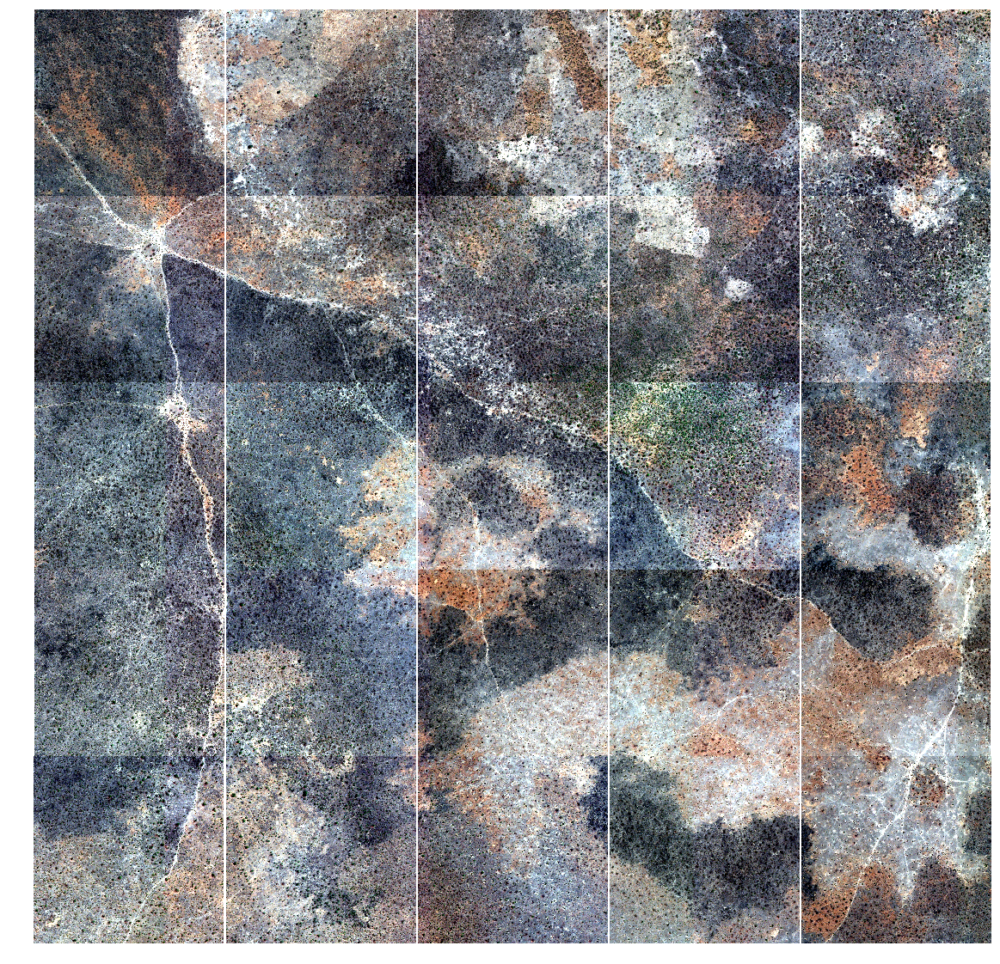

In [9]:
visualizer('6040')

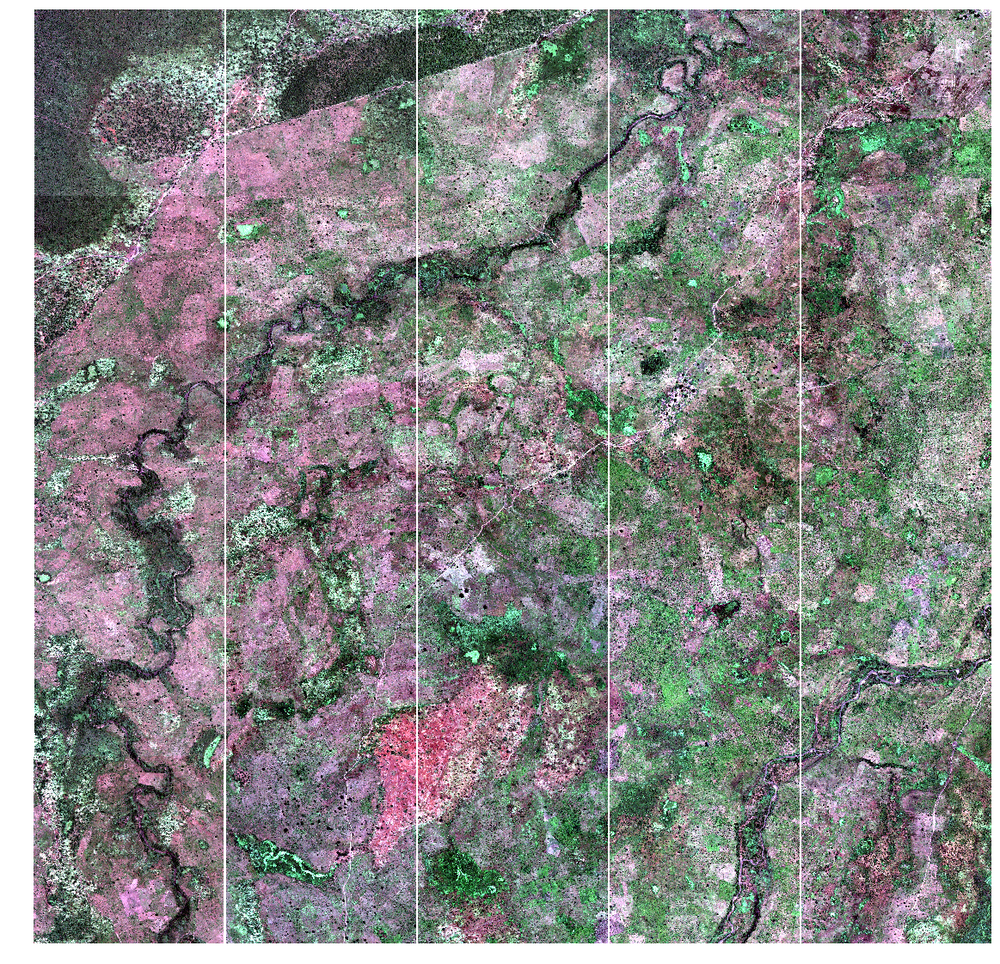

In [10]:
visualizer('6090')

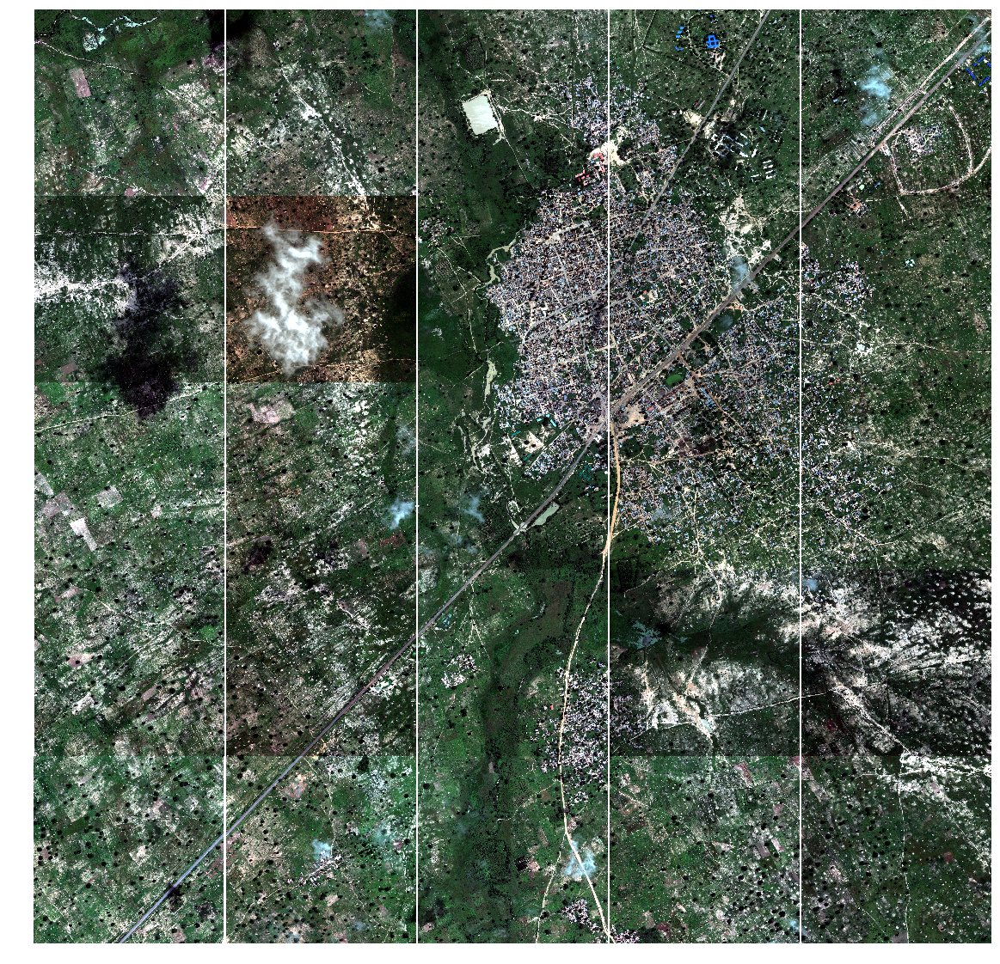

In [11]:
visualizer('6100')

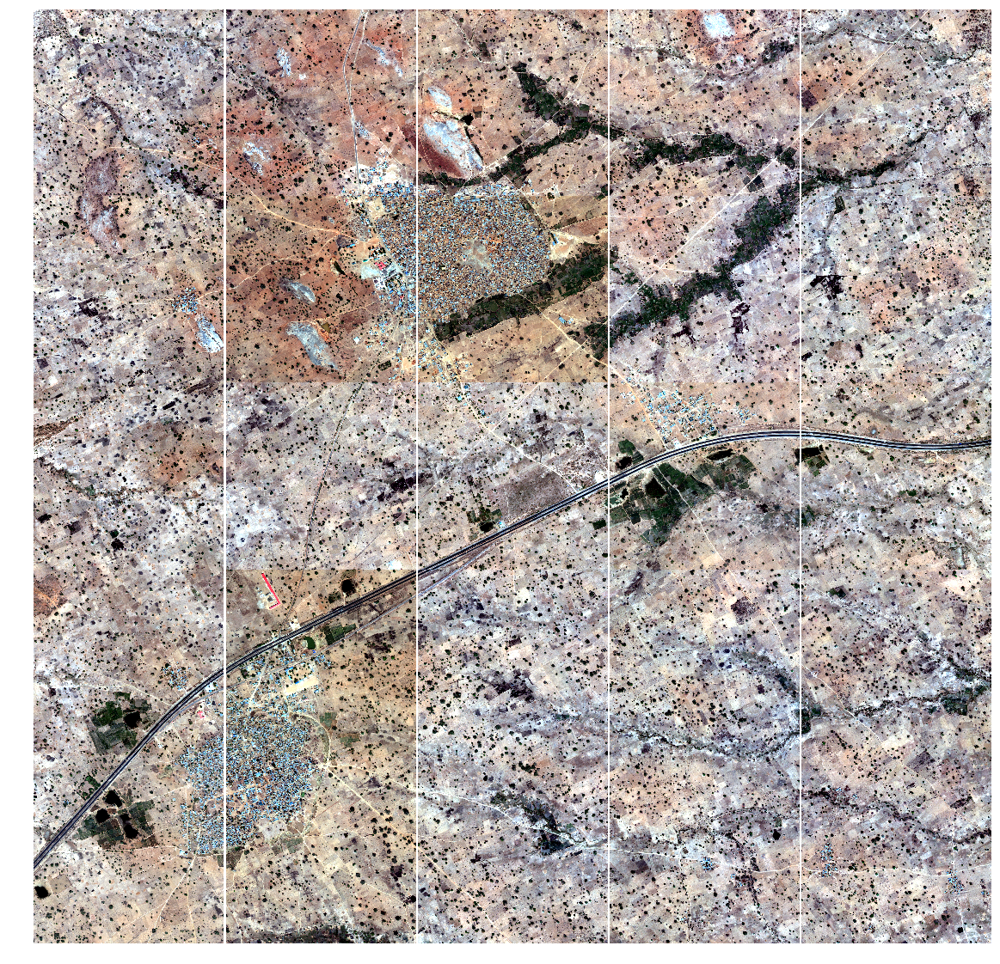

In [12]:
visualizer('6110')

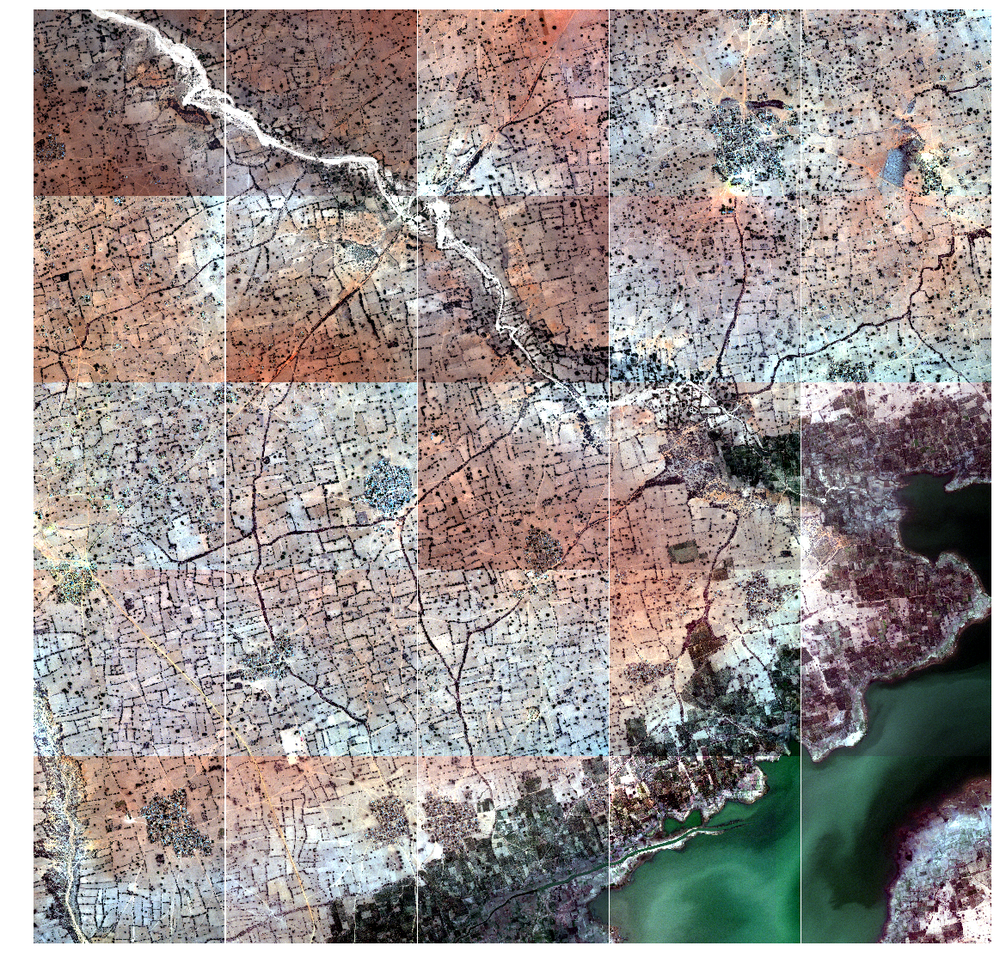

In [13]:
visualizer('6150')

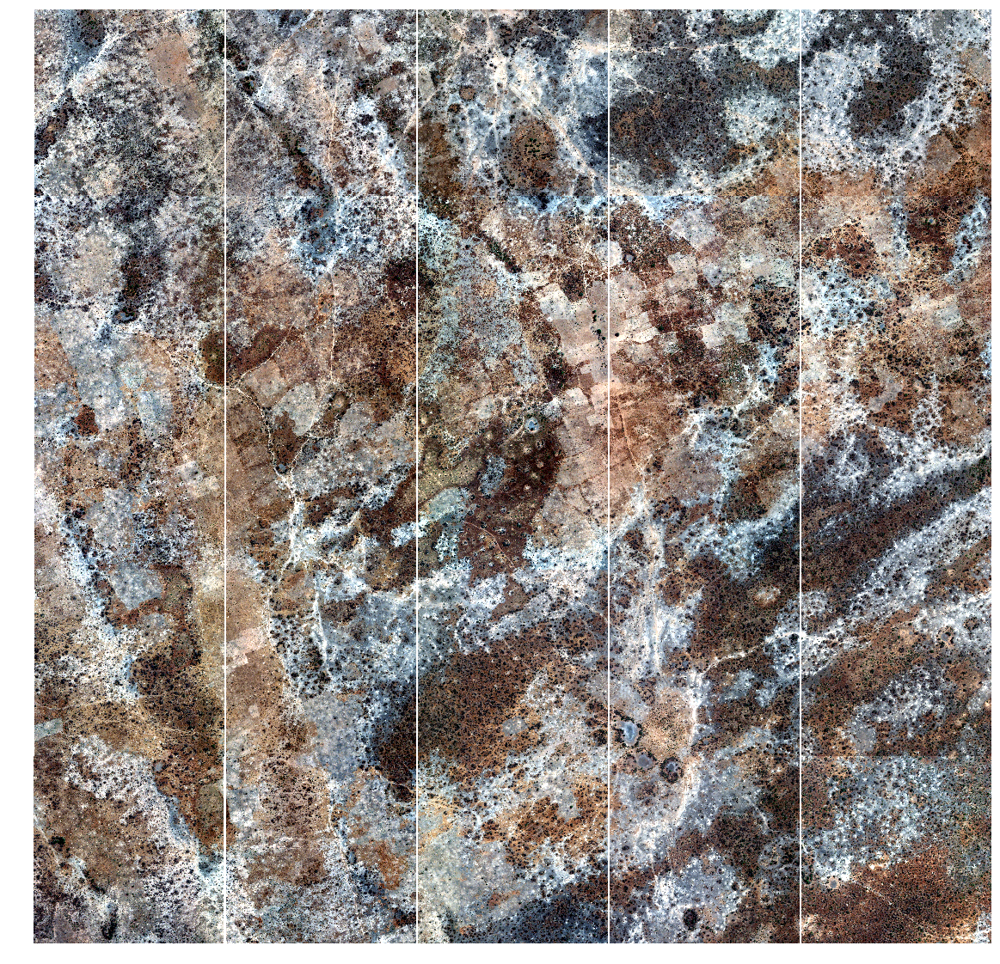

In [14]:
visualizer('6010')